<a href="https://colab.research.google.com/github/mwkoehler/xlnet/blob/main/XLNet_topic_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers
!pip install sentencepiece
!pip install ordered-set

     |████████████████████████████████| 2.1MB 21.0MB/s 
     |████████████████████████████████| 3.2MB 44.6MB/s 
     |████████████████████████████████| 890kB 41.3MB/s 
  Created wheel for sacremoses: filename=sacremoses-0.0.43-cp37-none-any.whl size=893262 sha256=b30063519e99f3f054f581216d2d87eaa8d0e49286327c59beefa8c6321f6264
  Stored in directory: /root/.cache/pip/wheels/29/3c/fd/7ce5c3f0666dab31a50123635e6fb5e19ceb42ce38d4e58f45
Successfully built sacremoses
     |████████████████████████████████| 1.2MB 20.0MB/s 
  Created wheel for ordered-set: filename=ordered_set-4.0.2-py2.py3-none-any.whl size=8210 sha256=b6521f5d865066ed7e2aec35b3b1cb76d0f06e25ae0c2a634ceac2612a15d315
  Stored in directory: /root/.cache/pip/wheels/e1/c6/9b/651d8a21d59b51a75ab9c070838f9231b8126421bc0569af47
Successfully built ordered-set


In [ ]:
import os
import math

import torch
from torch.nn import BCEWithLogitsLoss
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
from transformers import AdamW, XLNetTokenizer, XLNetModel, XLNetLMHeadModel, XLNetConfig
from keras.preprocessing.sequence import pad_sequences
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd
from tqdm import tqdm, trange
from ordered_set import OrderedSet
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
print("GPU Available: {}".format(torch.cuda.is_available()))
n_gpu = torch.cuda.device_count()
print("Number of GPU Available: {}".format(n_gpu))
print("GPU: {}".format(torch.cuda.get_device_name(0)))

GPU Available: True
Number of GPU Available: 1
GPU: Tesla T4


In [ ]:
#device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Import Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
all = pd.read_json('/content/drive/My Drive/data/alldocs2.json', orient='records')
all.columns = ['id', 'tags', 'text', 'lemmas']
all

,id,tags,text,lemmas
0,1001316036,[other],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ..."
1,1002219887,[tdd],Why Did we Build xUnit 1.0?\nhttp://xunit.gith...,"[whi, build, xunit, xunit, doc, whi, build, xu..."
2,1004048164,[gtd],David Allen Productive Living Newsletter\nBy u...,"[david, allen, product, live, newslett, campai..."
3,1004587500,[powershell],A Simpler If/Then Conditional Logic in PowerSh...,"[simpler, condit, logic, powershel, adamtheaut..."
4,1007374287,[programming],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b..."
...,...,...,...,...
4348,993690193,[programming],Learning to live with errors\nhttp://tomasp.ne...,"[learn, live, error, tomasp, net, blog, failur..."
4349,993949057,[powershell],Git for IT Professionals: Life Cycle of Reposi...,"[git, profession, life, cycl, repositori, file..."
4350,994814531,[computersecurity],How To Put Data At The Heart Of Your Security ...,"[put, data, heart, secur, practic, darkread, c..."
4351,997556985,[travel],The Best Last-Minute Weekend Getaways From New...,"[best, last, minut, weekend, getaway, new, yor..."


In [ ]:
def to_1D(series):
 return pd.Series([x for _list in series for x in _list])

In [ ]:
tagSet = set(to_1D(all['tags']))
tagList = sorted(tagSet)
tagList

['3dprint',
 '99pi',
 'aclu',
 'algorithms',
 'amazon',
 'android',
 'antitrust',
 'api',
 'apple',
 'apps',
 'asana',
 'aspnet',
 'async',
 'auth0',
 'azure',
 'backup',
 'backyard',
 'bettingmarkets',
 'biden',
 'biology',
 'bitcoin',
 'blogs',
 'books',
 'brain',
 'business',
 'charity',
 'chemistry',
 'china',
 'chrissy',
 'christopher',
 'ci/cd',
 'class',
 'climate',
 'clojure',
 'cloudflare',
 'color',
 'compsci',
 'compsec',
 'compsecurity',
 'computer',
 'computererrors',
 'computersecurity',
 'conservatism',
 'conspiracies',
 'conversations',
 'cooperstown',
 'cosmosdb',
 'covid',
 'cpp',
 'creativity',
 'crime',
 'csharp',
 'css',
 'cto',
 'data science',
 'database',
 'datacenter',
 'datasets',
 'datavis',
 'debug',
 'deep learning',
 'dellxps15',
 'design',
 'devops',
 'devtools',
 'digitalcontent',
 'documentdb',
 'domainnames',
 'dotnet',
 'drives',
 'drone',
 'economics',
 'ecycle',
 'eff',
 'electron',
 'email',
 'equality',
 'ethics',
 'evernote',
 'exercise',
 'faceb

In [ ]:
# '[]' in all['tags'].to_string()
testList = []
for index, row in all.iterrows():
    if len(row['tags']) == 0:
      testList.append(row.to_list())
test = pd.DataFrame(testList, columns=['id', 'tags', 'text', 'lemmas'])
test.head()

,id,tags,text,lemmas
0,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,..."
1,1030151717,[],College Calculus\nhttps://www.newyorker.com/ma...,"[colleg, calculus, newyork, com, magazin, coll..."
2,1126775635,[],Collection of MVVM helper classes for any appl...,"[collect, mvvm, helper, class, ani, applic, co..."
3,1271451593,[],Represent\nhttps://projects.propublica.org/rep...,"[repres, project, propublica, org, repres, see..."
4,171066886,[],How to notify a windows service(c#) of a DB Ta...,"[notifi, window, servic, tabl, chang, sql, sta..."


In [ ]:
trainList = []
for index, row in all.iterrows():
    if len(row['tags']) != 0:
      trainList.append(row.to_list())
train = pd.DataFrame(trainList, columns=['id', 'tags', 'text', 'lemmas'])
train.head()

,id,tags,text,lemmas
0,1001316036,[other],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ..."
1,1002219887,[tdd],Why Did we Build xUnit 1.0?\nhttp://xunit.gith...,"[whi, build, xunit, xunit, doc, whi, build, xu..."
2,1004048164,[gtd],David Allen Productive Living Newsletter\nBy u...,"[david, allen, product, live, newslett, campai..."
3,1004587500,[powershell],A Simpler If/Then Conditional Logic in PowerSh...,"[simpler, condit, logic, powershel, adamtheaut..."
4,1007374287,[programming],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b..."


In [ ]:
train.shape

(4149, 4)

In [ ]:
test.shape

(204, 4)

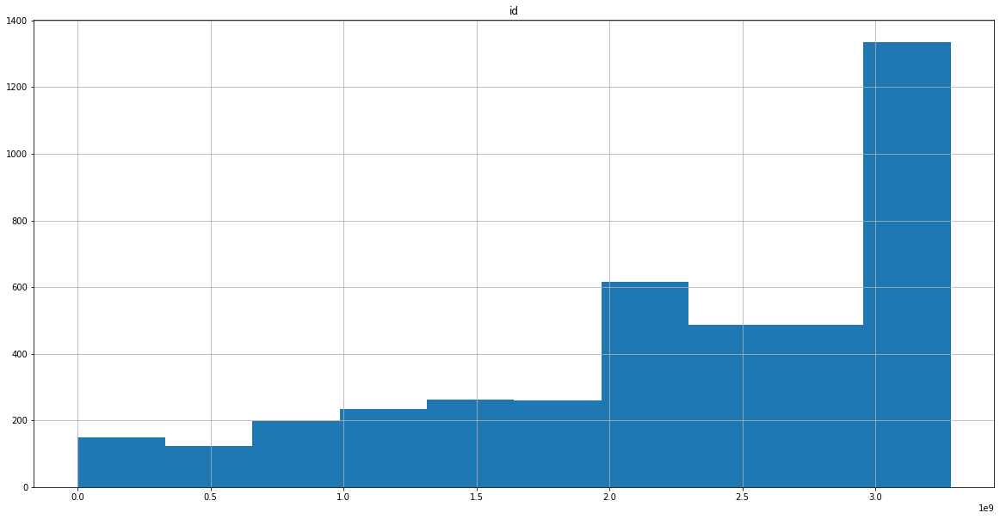

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10));
train[["id", "text"]].hist(ax=ax);

In [ ]:
train.isnull().mean()

id        0.0
tags      0.0
text      0.0
lemmas    0.0
dtype: float64

In [ ]:
test.isnull().mean()

id        0.0
tags      0.0
text      0.0
lemmas    0.0
dtype: float64

In [ ]:
# get small sample of train to try
#train = train.sample(n=100)

## Preprocess Data

In [ ]:
def plot_sentence_embeddings_length(text_list, tokenizer):
    tokenized_texts = list(map(lambda t: tokenizer.tokenize(t), text_list))
    tokenized_texts_len = list(map(lambda t: len(t), tokenized_texts))
    fig, ax = plt.subplots(figsize=(8, 5));
    ax.hist(tokenized_texts_len, bins=40);
    ax.set_xlabel("Length of Comment Embeddings");
    ax.set_ylabel("Number of Comments");
    return

In [ ]:
tokenizer = XLNetTokenizer.from_pretrained('xlnet-base-cased', do_lower_case=True)

In [ ]:
train_text_list = train["text"].values
test_text_list = test["text"].values

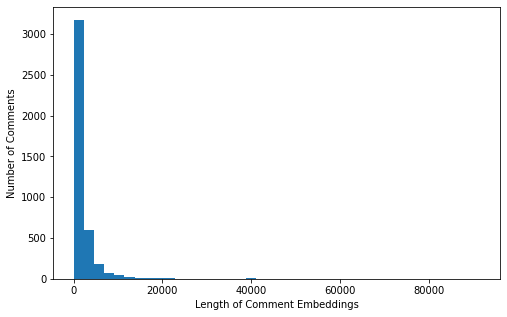

In [ ]:
plot_sentence_embeddings_length(train_text_list, tokenizer)

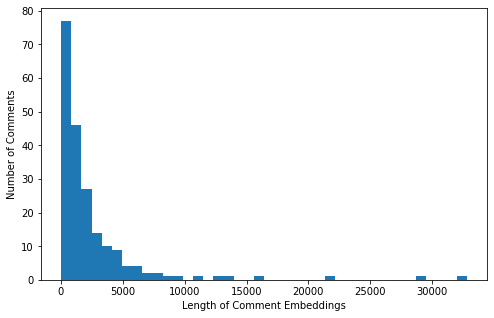

In [ ]:
plot_sentence_embeddings_length(test_text_list, tokenizer)

In [ ]:
def tokenize_inputs(text_list, tokenizer, num_embeddings=512):
    """
    Tokenizes the input text input into ids. Appends the appropriate special
    characters to the end of the text to denote end of sentence. Truncate or pad
    the appropriate sequence length.
    """
    # tokenize the text, then truncate sequence to the desired length minus 2 for
    # the 2 special characters
    tokenized_texts = list(map(lambda t: tokenizer.tokenize(t)[:num_embeddings-2], text_list))
    # convert tokenized text into numeric ids for the appropriate LM
    input_ids = [tokenizer.convert_tokens_to_ids(x) for x in tokenized_texts]
    # append special token "<s>" and </s> to end of sentence
    input_ids = [tokenizer.build_inputs_with_special_tokens(x) for x in input_ids]
    # pad sequences
    input_ids = pad_sequences(input_ids, maxlen=num_embeddings, dtype="long", truncating="post", padding="post")
    return input_ids

def create_attn_masks(input_ids):
    """
    Create attention masks to tell model whether attention should be applied to
    the input id tokens. Do not want to perform attention on padding tokens.
    """
    # Create attention masks
    attention_masks = []

    # Create a mask of 1s for each token followed by 0s for padding
    for seq in input_ids:
        seq_mask = [float(i>0) for i in seq]
        attention_masks.append(seq_mask)
    return attention_masks

In [ ]:
# create input id tokens
train_input_ids = tokenize_inputs(train_text_list, tokenizer, num_embeddings=250)
train_input_ids

array([[13295,  9756,    25, ...,    86,     4,     3],
       [  611,   190,    80, ...,     0,     0,     0],
       [ 8075,  7791,    71, ...,   286,     4,     3],
       ...,
       [  160,    22,   331, ...,   434,     4,     3],
       [   18,   252,   129, ...,    19,     4,     3],
       [   17,  4501,  6038, ...,  4501,     4,     3]])

In [ ]:
# create input id tokens
test_input_ids = tokenize_inputs(test_text_list, tokenizer, num_embeddings=250)
test_input_ids

array([[   49,  2731, 19945, ...,     0,     0,     0],
       [ 1377, 31136,  4538, ...,  5859,     4,     3],
       [ 1692,    20,    17, ...,     9,     4,     3],
       ...,
       [26434,    21,    18, ...,   113,     4,     3],
       [ 6342,  4538,    23, ...,    22,     4,     3],
       [   17,   213,   469, ...,   809,     4,     3]])

In [ ]:
# create attention masks
train_attention_masks = create_attn_masks(train_input_ids)
train_attention_masks

[[1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,

In [ ]:
# create attention masks
test_attention_masks = create_attn_masks(test_input_ids)
test_attention_masks

[[1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,

In [ ]:
# add input ids and attention masks to the dataframe
train["features"] = train_input_ids.tolist()
train["masks"] = train_attention_masks

test["features"] = test_input_ids.tolist()
test["masks"] = test_attention_masks

In [ ]:
train.head()

,id,tags,text,lemmas,features,masks
0,1001316036,[other],Collaborative Editing in ProseMirror\nhttps://...,"[collabor, edit, prosemirror, marijnhaverbek, ...","[13295, 9756, 25, 18957, 6687, 213, 218, 4538,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
1,1002219887,[tdd],Why Did we Build xUnit 1.0?\nhttp://xunit.gith...,"[whi, build, xunit, xunit, doc, whi, build, xu...","[611, 190, 80, 1266, 3512, 15320, 156, 9, 279,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
2,1004048164,[gtd],David Allen Productive Living Newsletter\nBy u...,"[david, allen, product, live, newslett, campai...","[8075, 7791, 71, 254, 10229, 826, 7950, 37, 21...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
3,1004587500,[powershell],A Simpler If/Then Conditional Logic in PowerSh...,"[simpler, condit, logic, powershel, adamtheaut...","[24, 16513, 108, 167, 10067, 22146, 9295, 25, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
4,1007374287,[programming],Big List of Naughty Strings\nhttps://github.co...,"[big, list, naughti, string, com, minimaxir, b...","[534, 649, 20, 31356, 13470, 4538, 23, 4315, 3...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."


In [ ]:
test.head()

,id,tags,text,lemmas,features,masks
0,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,...","[49, 2731, 19945, 792, 832, 8097, 4538, 23, 43...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
1,1030151717,[],College Calculus\nhttps://www.newyorker.com/ma...,"[colleg, calculus, newyork, com, magazin, coll...","[1377, 31136, 4538, 23, 4315, 1105, 9, 30183, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
2,1126775635,[],Collection of MVVM helper classes for any appl...,"[collect, mvvm, helper, class, ani, applic, co...","[1692, 20, 17, 98, 1232, 1232, 98, 222, 118, 2...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
3,1271451593,[],Represent\nhttps://projects.propublica.org/rep...,"[repres, project, propublica, org, repres, see...","[3109, 4538, 23, 4315, 25184, 23, 9, 3143, 135...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."
4,171066886,[],How to notify a windows service(c#) of a DB Ta...,"[notifi, window, servic, tabl, chang, sql, sta...","[160, 22, 13506, 24, 3367, 348, 10, 369, 7967,...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ..."


## Train, Valid Split

In [ ]:
# train valid split
train, valid = train_test_split(train, test_size=0.2, random_state=42)

In [ ]:
# Append a column for each tag set to 0 or 1 to indicate it does or does not apply
col = []
for tag in tagList:
  for index, row in train.iterrows():
      if tag in row['tags']:
        col.append(1)
      else:    
        col.append(0)
  train[tag] = col
  col = []
  for index, row in valid.iterrows():
      if tag in row['tags']:
        col.append(1)
      else:    
        col.append(0)
  valid[tag] = col
  col = []
  

In [ ]:
train.head()

,id,tags,text,lemmas,features,masks,3dprint,99pi,aclu,algorithms,amazon,android,antitrust,api,apple,apps,asana,aspnet,async,auth0,azure,backup,backyard,bettingmarkets,biden,biology,bitcoin,blogs,books,brain,business,charity,chemistry,china,chrissy,christopher,ci/cd,class,climate,clojure,...,terminal,testing,tools,toomanylaws,transitchek,travel,travelhacking,trump,typescript,typing,typography,unicode,unions,unknown,urbandesign,ux,video,visualstudio,voting,vpn,vscode,vsto,vstudio,waitbutwhy,walking,watch,webhosting,wedding,wifi,will,windows,wordpress,writing,wsl,xamarin,xaml,xml,xpath,zettelkasten,zettlekasten
2868,3034385478,[covid],Coronavirus dashboard for June 29: renewed exp...,"[covid, dashboard, renew, exponenti, growth, i...","[17, 29316, 13738, 27994, 28, 17, 10003, 93, 1...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2473,2975518947,[computer],How to Serve Over 100K Web Pages a Day on a Sl...,"[serv, web, page, day, slow, home, internet, c...","[160, 22, 1613, 95, 842, 267, 1015, 2366, 24, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1662,2415995064,[economics],The most screwed-up employee perk in America (...,"[screw, employe, perk, america, man, might, fi...","[18, 127, 23906, 13, 499, 3820, 451, 267, 25, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3135,3105547887,[economics],Henderson and Horton on Whether China is an Ec...,"[henderson, horton, whether, china, econom, th...","[43, 14912, 672, 21, 17, 7049, 577, 31, 548, 1...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1551,2362656871,[international],"The U.S. Needs Saudi Arabia, and Vice Versa\nh...","[need, saudi, arabia, vice, versa, bloomberg, ...","[18, 17, 660, 9, 23, 9, 794, 17, 23, 21735, 17...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
valid.head()

,id,tags,text,lemmas,features,masks,3dprint,99pi,aclu,algorithms,amazon,android,antitrust,api,apple,apps,asana,aspnet,async,auth0,azure,backup,backyard,bettingmarkets,biden,biology,bitcoin,blogs,books,brain,business,charity,chemistry,china,chrissy,christopher,ci/cd,class,climate,clojure,...,terminal,testing,tools,toomanylaws,transitchek,travel,travelhacking,trump,typescript,typing,typography,unicode,unions,unknown,urbandesign,ux,video,visualstudio,voting,vpn,vscode,vsto,vstudio,waitbutwhy,walking,watch,webhosting,wedding,wifi,will,windows,wordpress,writing,wsl,xamarin,xaml,xml,xpath,zettelkasten,zettlekasten
149,1225803449,[raspberrypi],Using Visual Studio Code with a Raspberry Pi (...,"[use, vstudio, code, raspberri, raspbian, this...","[381, 4689, 2837, 1713, 33, 24, 21810, 7213, 1...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1973,2670498809,[deep learning],Getting Started with Text Preprocessing for Ma...,"[get, start, text, preprocess, machin, learn, ...","[723, 505, 33, 1758, 956, 21749, 28, 2138, 189...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3378,3183357458,[dotnet],.NET Blog\nhttps://devblogs.microsoft.com/dotn...,"[net, blog, devblog, microsoft, com, dotnet, d...","[17, 9, 1942, 2780, 4538, 23, 4315, 16699, 182...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3619,3249076600,[programming],Building a social media platform without going...,"[build, social, medium, platform, without, ban...","[540, 24, 796, 789, 3081, 286, 223, 15158, 446...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2672,3012062101,[math],The ‘Useless' Perspective That Transformed Mat...,"[useless, perspect, transform, mathemat, quant...","[18, 2302, 3006, 832, 26, 5109, 29, 9966, 1009...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
train_features = train["features"].values.tolist()
valid_features = valid["features"].values.tolist()

train_masks = train["masks"].values.tolist()
valid_masks = valid["masks"].values.tolist()

train_tags = train[tagList].values.tolist()
valid_tags = valid[tagList].values.tolist()

In [ ]:
train_features 

[[17,
  29316,
  13738,
  27994,
  28,
  17,
  10003,
  93,
  1875,
  60,
  7070,
  25977,
  849,
  25,
  10296,
  19,
  3113,
  25,
  3945,
  51,
  12999,
  4538,
  23,
  4315,
  2075,
  844,
  18127,
  18239,
  9,
  756,
  167,
  1459,
  1459,
  167,
  4055,
  167,
  29316,
  13738,
  13,
  66,
  4909,
  2330,
  13,
  1383,
  13,
  10003,
  93,
  13,
  2821,
  13,
  88,
  4652,
  68,
  13,
  8882,
  253,
  12046,
  13,
  18658,
  13,
  153,
  13,
  153,
  11790,
  3685,
  13,
  9538,
  814,
  13,
  153,
  13,
  22378,
  23,
  13,
  7270,
  13,
  14648,
  782,
  9,
  17477,
  652,
  211,
  10296,
  60,
  159,
  19,
  217,
  3437,
  19,
  279,
  4555,
  19,
  4087,
  19,
  1608,
  174,
  25,
  129,
  191,
  652,
  211,
  3945,
  60,
  11518,
  19,
  2728,
  233,
  19,
  1514,
  233,
  25,
  129,
  191,
  193,
  27,
  18,
  1736,
  11698,
  20,
  18,
  425,
  191,
  905,
  20,
  109,
  1057,
  451,
  12788,
  60,
  105,
  27,
  7070,
  25977,
  849,
  25,
  18,
  1047,
  21,
  1750,
  9

In [ ]:
valid_features

[[381,
  4689,
  2837,
  1713,
  33,
  24,
  21810,
  7213,
  17,
  2742,
  17,
  10,
  840,
  3848,
  12577,
  11,
  4538,
  23,
  4315,
  7567,
  1011,
  189,
  1315,
  9,
  756,
  167,
  12128,
  13,
  25722,
  13,
  10469,
  1888,
  13,
  10570,
  13,
  3263,
  13,
  101,
  13,
  840,
  3848,
  7213,
  13,
  2742,
  13,
  840,
  3848,
  12577,
  167,
  17,
  13304,
  7567,
  1011,
  189,
  1315,
  381,
  4689,
  2837,
  1713,
  33,
  24,
  21810,
  7213,
  17,
  2742,
  17,
  10,
  840,
  3848,
  12577,
  11,
  80,
  26,
  88,
  126,
  33,
  120,
  17,
  10191,
  98,
  17,
  10,
  25412,
  135,
  441,
  11,
  461,
  20,
  17393,
  9,
  1315,
  23,
  11279,
  23,
  21,
  80,
  26,
  88,
  5343,
  56,
  76,
  21,
  723,
  1237,
  22,
  1874,
  106,
  1713,
  136,
  80,
  26,
  189,
  2350,
  160,
  22,
  1266,
  24,
  21810,
  7213,
  17,
  2742,
  40,
  18,
  881,
  76,
  208,
  17393,
  9,
  1315,
  23,
  17,
  19,
  80,
  26,
  189,
  927,
  24,
  1015,
  3441,
  25,
  17393,
  28

In [ ]:
train_tags

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


In [ ]:
valid_tags

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


## Create Dataloaders

In [ ]:
# Convert all of our input ids and attention masks into 
# torch tensors, the required datatype for our model
train_features = torch.tensor(train_features)
valid_features = torch.tensor(valid_features)

In [ ]:
train_tags = torch.tensor(train_tags, dtype=torch.float32)
valid_tags = torch.tensor(valid_tags, dtype=torch.float32)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


In [ ]:
train_masks = torch.tensor(train_masks, dtype=torch.long)
valid_masks = torch.tensor(valid_masks, dtype=torch.long)

In [ ]:
# Select a batch size for training
batch_size = 16

# Create an iterator of our data with torch DataLoader. This helps save on 
# memory during training because, unlike a for loop, 
# with an iterator the entire dataset does not need to be loaded into memory

train_data = TensorDataset(train_features, train_masks, train_tags)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data,\
                              sampler=train_sampler,\
                              batch_size=batch_size)

validation_data = TensorDataset(valid_features, valid_masks, valid_tags)
validation_sampler = SequentialSampler(validation_data)
validation_dataloader = DataLoader(validation_data,\
                                   sampler=validation_sampler,\
                                   batch_size=batch_size)

In [ ]:
def train(model, num_epochs,\
          optimizer,\
          train_dataloader, valid_dataloader,\
          model_save_path,\
          train_loss_set=[], valid_loss_set = [],\
          lowest_eval_loss=None, start_epoch=0,\
          device="cpu"
          ):
  """
  Train the model and save the model with the lowest validation loss
  """

  model.to(device)

  # trange is a tqdm wrapper around the normal python range
  for i in trange(num_epochs, desc="Epoch"):
    # if continue training from saved model
    actual_epoch = start_epoch + i

    # Training

    # Set our model to training mode (as opposed to evaluation mode)
    model.train()

    # Tracking variables
    tr_loss = 0
    num_train_samples = 0

    # Train the data for one epoch
    for step, batch in enumerate(train_dataloader):
      # Add batch to GPU
      batch = tuple(t.to(device) for t in batch)
      # Unpack the inputs from our dataloader
      b_input_ids, b_input_mask, b_labels = batch
      # Clear out the gradients (by default they accumulate)
      optimizer.zero_grad()
      # Forward pass
      loss = model(b_input_ids, attention_mask=b_input_mask, labels=b_labels)
      # store train loss
      tr_loss += loss.item()
      num_train_samples += b_labels.size(0)
      # Backward pass
      loss.backward()
      # Update parameters and take a step using the computed gradient
      optimizer.step()
      #scheduler.step()

    # Update tracking variables
    epoch_train_loss = tr_loss/num_train_samples
    train_loss_set.append(epoch_train_loss)

    print("Train loss: {}".format(epoch_train_loss))

    # Validation

    # Put model in evaluation mode to evaluate loss on the validation set
    model.eval()

    # Tracking variables 
    eval_loss = 0
    num_eval_samples = 0

    # Evaluate data for one epoch
    for batch in valid_dataloader:
      # Add batch to GPU
      batch = tuple(t.to(device) for t in batch)
      # Unpack the inputs from our dataloader
      b_input_ids, b_input_mask, b_labels = batch
      # Telling the model not to compute or store gradients,
      # saving memory and speeding up validation
      with torch.no_grad():
        # Forward pass, calculate validation loss
        loss = model(b_input_ids, attention_mask=b_input_mask, labels=b_labels)
        # store valid loss
        eval_loss += loss.item()
        num_eval_samples += b_labels.size(0)

    epoch_eval_loss = eval_loss/num_eval_samples
    valid_loss_set.append(epoch_eval_loss)

    print("Valid loss: {}".format(epoch_eval_loss))

    if lowest_eval_loss == None:
      lowest_eval_loss = epoch_eval_loss
      # save model
      save_model(model, model_save_path, actual_epoch,\
                 lowest_eval_loss, train_loss_set, valid_loss_set)
    else:
      if epoch_eval_loss < lowest_eval_loss:
        lowest_eval_loss = epoch_eval_loss
        # save model
        save_model(model, model_save_path, actual_epoch,\
                   lowest_eval_loss, train_loss_set, valid_loss_set)
    print("\n")

  return model, train_loss_set, valid_loss_set


def save_model(model, save_path, epochs, lowest_eval_loss, train_loss_hist, valid_loss_hist):
  """
  Save the model to the path directory provided
  """
  model_to_save = model.module if hasattr(model, 'module') else model
  checkpoint = {'epochs': epochs, \
                'lowest_eval_loss': lowest_eval_loss,\
                'state_dict': model_to_save.state_dict(),\
                'train_loss_hist': train_loss_hist,\
                'valid_loss_hist': valid_loss_hist
               }
  torch.save(checkpoint, save_path)
  print("Saving model at epoch {} with validation loss of {}".format(epochs,\
                                                                     lowest_eval_loss))
  return
  
def load_model(save_path):
  """
  Load the model from the path directory provided
  """
  checkpoint = torch.load(save_path)
  model_state_dict = checkpoint['state_dict']
  model = XLNetForMultiLabelSequenceClassification(num_labels=model_state_dict["classifier.weight"].size()[0])
  model.load_state_dict(model_state_dict)

  epochs = checkpoint["epochs"]
  lowest_eval_loss = checkpoint["lowest_eval_loss"]
  train_loss_hist = checkpoint["train_loss_hist"]
  valid_loss_hist = checkpoint["valid_loss_hist"]
  
  return model, epochs, lowest_eval_loss, train_loss_hist, valid_loss_hist

## Train Model from Scratch

In [ ]:
torch.cuda.empty_cache()

In [ ]:
#config = XLNetConfig()
        
class XLNetForMultiLabelSequenceClassification(torch.nn.Module):
  
  def __init__(self, num_labels=2):
    super(XLNetForMultiLabelSequenceClassification, self).__init__()
    self.num_labels = num_labels
    self.xlnet = XLNetModel.from_pretrained('xlnet-base-cased')
    self.classifier = torch.nn.Linear(768, num_labels)

    torch.nn.init.xavier_normal_(self.classifier.weight)

  def forward(self, input_ids, token_type_ids=None,\
              attention_mask=None, labels=None):
    # last hidden layer
    last_hidden_state = self.xlnet(input_ids=input_ids,\
                                   attention_mask=attention_mask,\
                                   token_type_ids=token_type_ids)
    # pool the outputs into a mean vector
    mean_last_hidden_state = self.pool_hidden_state(last_hidden_state)
    logits = self.classifier(mean_last_hidden_state)
        
    if labels is not None:
      loss_fct = BCEWithLogitsLoss()
      loss = loss_fct(logits.view(-1, self.num_labels),\
                      labels.view(-1, self.num_labels))
      return loss
    else:
      return logits
    
  def freeze_xlnet_decoder(self):
    """
    Freeze XLNet weight parameters. They will not be updated during training.
    """
    for param in self.xlnet.parameters():
      param.requires_grad = False
    
  def unfreeze_xlnet_decoder(self):
    """
    Unfreeze XLNet weight parameters. They will be updated during training.
    """
    for param in self.xlnet.parameters():
      param.requires_grad = True
    
  def pool_hidden_state(self, last_hidden_state):
    """
    Pool the output vectors into a single mean vector 
    """
    last_hidden_state = last_hidden_state[0]
    mean_last_hidden_state = torch.mean(last_hidden_state, 1)
    return mean_last_hidden_state
    
model = XLNetForMultiLabelSequenceClassification(num_labels=len(valid_tags[0]))
#model = torch.nn.DataParallel(model)
#model.cuda()

In [ ]:
optimizer = AdamW(model.parameters(), lr=2e-5, weight_decay=0.01, correct_bias=False)
#scheduler = WarmupLinearSchedule(optimizer, warmup_steps=num_warmup_steps, t_total=num_total_steps)  # PyTorch scheduler

In [ ]:
num_epochs=3

cwd = os.getcwd()
model_save_path = output_model_file = os.path.join(cwd, "drive/My Drive/Models/xlnet_toxic.bin")
model, train_loss_set, valid_loss_set = train(model=model,\
                                              num_epochs=num_epochs,\
                                              optimizer=optimizer,\
                                              train_dataloader=train_dataloader,\
                                              valid_dataloader=validation_dataloader,\
                                              model_save_path=model_save_path,\
                                              device="cuda")

Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Train loss: 0.0036718812719229907
Valid loss: 0.0012557639448667866


Epoch:  33%|███▎      | 1/3 [04:37<09:14, 277.08s/it]

Saving model at epoch 0 with validation loss of 0.0012557639448667866


Train loss: 0.0011879098791046543
Valid loss: 0.0011936506402330945


Epoch:  67%|██████▋   | 2/3 [09:20<04:39, 279.08s/it]

Saving model at epoch 1 with validation loss of 0.0011936506402330945


Train loss: 0.001112529522795191


Epoch: 100%|██████████| 3/3 [14:02<00:00, 280.71s/it]

Valid loss: 0.001211809860654624




Text(0.5, 1.0, 'Loss vs Number of Epochs')

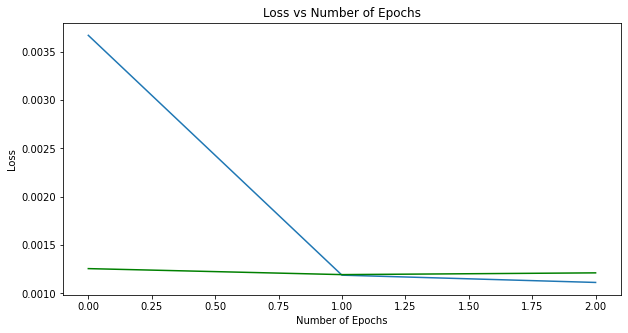

In [ ]:
# Plot loss
num_epochs = np.arange(len(train_loss_set))

fig, ax = plt.subplots(figsize=(10, 5));
ax.plot(num_epochs, np.array(train_loss_set), label="Train Loss")
ax.plot(num_epochs, np.array(valid_loss_set), 'g-', label="Valid Loss")
#ax1.plot(episode_record, lose_record, 'r-', label="Lose %")
ax.set_xlabel("Number of Epochs")
ax.set_ylabel("Loss")
ax.set_title("Loss vs Number of Epochs")

## Train Model From Previous Checkpoint

In [ ]:
cwd = os.getcwd()
model_save_path = output_model_file = os.path.join(cwd, "drive/My Drive/Models/xlnet_toxic.bin")
model, start_epoch, lowest_eval_loss, train_loss_hist, valid_loss_hist = load_model(model_save_path)

In [ ]:
optimizer = AdamW(model.parameters(), lr=2e-5, weight_decay=0.01, correct_bias=False)

In [ ]:
num_epochs=3
model, train_loss_set, valid_loss_set = train(model=model,\
                                              num_epochs=num_epochs,\
                                              optimizer=optimizer,\
                                              train_dataloader=train_dataloader,\
                                              valid_dataloader=validation_dataloader,\
                                              model_save_path=model_save_path,\
                                              train_loss_set=train_loss_hist,\
                                              valid_loss_set=valid_loss_hist,\
                                              lowest_eval_loss=lowest_eval_loss,\
                                              start_epoch=start_epoch,\
                                              device="cuda")

Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Train loss: 0.000985642028178399
Valid loss: 0.0008637884895440685


Epoch:  33%|███▎      | 1/3 [04:43<09:27, 283.98s/it]

Saving model at epoch 1 with validation loss of 0.0008637884895440685


Train loss: 0.0006604903543429154
Valid loss: 0.0007723269855087421


Epoch:  67%|██████▋   | 2/3 [09:27<04:43, 283.81s/it]

Saving model at epoch 2 with validation loss of 0.0007723269855087421


Train loss: 0.0004913761987176626
Valid loss: 0.0007457313537373241


Epoch: 100%|██████████| 3/3 [14:11<00:00, 283.76s/it]

Saving model at epoch 3 with validation loss of 0.0007457313537373241




Text(0.5, 1.0, 'Loss vs Number of Epochs')

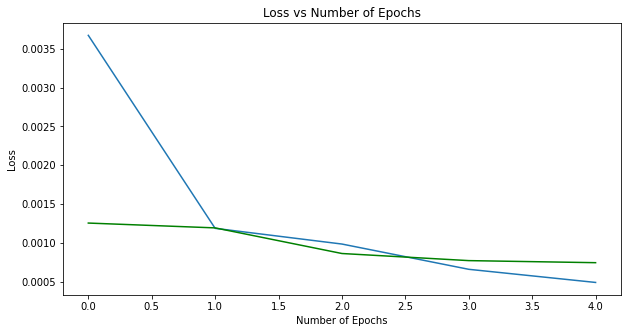

In [ ]:
# Plot loss
num_epochs = np.arange(len(train_loss_set))

fig, ax = plt.subplots(figsize=(10, 5));
ax.plot(num_epochs, np.array(train_loss_set), label="Train Loss")
ax.plot(num_epochs, np.array(valid_loss_set), 'g-', label="Valid Loss")
#ax1.plot(episode_record, lose_record, 'r-', label="Lose %")
ax.set_xlabel("Number of Epochs")
ax.set_ylabel("Loss")
ax.set_title("Loss vs Number of Epochs")

## Get Predictions

In [ ]:
def generate_predictions(model, df, num_labels, device="cpu", batch_size=32):
  num_iter = math.ceil(df.shape[0]/batch_size)
  
  pred_probs = np.array([]).reshape(0, num_labels)
  
  model.to(device)
  model.eval()
  
  for i in range(num_iter):
    df_subset = df.iloc[i*batch_size:(i+1)*batch_size,:]
    X = df_subset["features"].values.tolist()
    masks = df_subset["masks"].values.tolist()
    X = torch.tensor(X)
    masks = torch.tensor(masks, dtype=torch.long)
    X = X.to(device)
    masks = masks.to(device)
    with torch.no_grad():
      logits = model(input_ids=X, attention_mask=masks)
      logits = logits.sigmoid().detach().cpu().numpy()
      pred_probs = np.vstack([pred_probs, logits])
  
  return pred_probs

In [ ]:
num_labels = len(tagList)
pred_probs = generate_predictions(model, test, num_labels, device="cuda", batch_size=32)
pred_probs

array([[1.93276181e-04, 4.39407886e-04, 1.17845913e-04, ...,
        3.82313920e-06, 1.16268387e-02, 2.04996485e-02],
       [1.74896777e-05, 2.33020447e-03, 7.02726975e-05, ...,
        6.07326058e-07, 7.77775375e-03, 4.09494123e-06],
       [1.20796003e-05, 9.32288458e-05, 1.92733933e-05, ...,
        3.71461056e-06, 1.70164843e-04, 1.14192706e-04],
       ...,
       [1.61003583e-04, 1.54944399e-04, 4.74474626e-04, ...,
        2.17077854e-06, 4.51666099e-04, 1.68119045e-03],
       [3.81840800e-05, 3.31381380e-05, 3.49093042e-03, ...,
        8.44390001e-07, 5.44587165e-05, 3.98021875e-05],
       [1.61545795e-05, 7.67160509e-06, 6.79189252e-05, ...,
        9.62006879e-07, 4.00241661e-05, 8.69646552e-04]])

In [ ]:
label_cols = tagList

for idx,tag in enumerate(tagList):
  test[tag] = pred_probs[:,idx]

In [ ]:
test.head()

,id,tags,text,lemmas,features,masks,3dprint,99pi,aclu,algorithms,amazon,android,antitrust,api,apple,apps,asana,aspnet,async,auth0,azure,backup,backyard,bettingmarkets,biden,biology,bitcoin,blogs,books,brain,business,charity,chemistry,china,chrissy,christopher,ci/cd,class,climate,clojure,...,terminal,testing,tools,toomanylaws,transitchek,travel,travelhacking,trump,typescript,typing,typography,unicode,unions,unknown,urbandesign,ux,video,visualstudio,voting,vpn,vscode,vsto,vstudio,waitbutwhy,walking,watch,webhosting,wedding,wifi,will,windows,wordpress,writing,wsl,xamarin,xaml,xml,xpath,zettelkasten,zettlekasten
0,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,...","[49, 2731, 19945, 792, 832, 8097, 4538, 23, 43...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000193,0.000439,0.000118,0.000504,0.000095,0.000854,0.000014,0.004365,0.000863,0.000058,0.000269,0.002829,0.000182,0.000033,0.002633,0.001279,0.000174,0.000459,0.002034,0.000126,0.000789,0.000049,0.000416,0.000838,0.000288,0.000017,0.000034,0.000056,0.000027,0.000092,0.001288,0.001556,0.000011,0.001024,...,0.000234,0.000069,0.001231,0.000010,0.000010,0.001976,0.000088,0.000032,0.012941,0.079396,0.013452,0.000046,0.000052,0.000165,0.000016,0.001430,0.001287,0.000536,0.000143,0.000066,0.000994,0.000082,0.000526,0.005187,0.000222,0.000369,0.000163,0.000225,0.000099,0.000486,0.064478,0.000189,0.000673,0.003458,0.002909,0.000013,0.000019,3.823139e-06,0.011627,0.020500
1,1030151717,[],College Calculus\nhttps://www.newyorker.com/ma...,"[colleg, calculus, newyork, com, magazin, coll...","[1377, 31136, 4538, 23, 4315, 1105, 9, 30183, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000017,0.002330,0.000070,0.000670,0.000039,0.000056,0.000129,0.000070,0.000540,0.000002,0.000196,0.000410,0.000087,0.000035,0.000001,0.000154,0.000136,0.000016,0.006393,0.000361,0.000025,0.000042,0.078681,0.001312,0.000026,0.001064,0.000028,0.006253,0.000553,0.001323,0.000013,0.000677,0.000811,0.000008,...,0.000012,0.000078,0.000575,0.000315,0.000055,0.003120,0.000586,0.004636,0.000041,0.000184,0.000349,0.000013,0.000653,0.000569,0.000015,0.000015,0.000210,0.000021,0.000413,0.000059,0.000182,0.000040,0.000142,0.003685,0.000043,0.000033,0.000022,0.000078,0.000130,0.000109,0.000233,0.000046,0.002439,0.000286,0.000078,0.000423,0.000024,6.073261e-07,0.007778,0.000004
2,1126775635,[],Collection of MVVM helper classes for any appl...,"[collect, mvvm, helper, class, ani, applic, co...","[1692, 20, 17, 98, 1232, 1232, 98, 222, 118, 2...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000012,0.000093,0.000019,0.000028,0.000062,0.000150,0.000041,0.000177,0.000136,0.000009,0.000086,0.000714,0.000207,0.000469,0.000223,0.000020,0.000148,0.000027,0.000087,0.000104,0.000005,0.000032,0.000320,0.000047,0.000031,0.000023,0.000060,0.000216,0.000046,0.000047,0.000794,0.000109,0.000030,0.000064,...,0.000078,0.000015,0.000013,0.000035,0.000001,0.000115,0.000019,0.000024,0.000406,0.000062,0.000051,0.000018,0.000015,0.000038,0.000009,0.000014,0.000021,0.000236,0.000055,0.000063,0.000283,0.000071,0.000812,0.000082,0.000015,0.000024,0.000129,0.000113,0.000034,0.000029,0.000336,0.000011,0.000131,0.000305,0.944860,0.000272,0.000023,3.714611e-06,0.000170,0.000114
3,1271451593,[],Represent\nhttps://projects.propublica.org/rep...,"[repres, project, propublica, org, repres, see...","[3109, 4538, 23, 4315, 25184, 23, 9, 3143, 135...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000597,0.000416,0.000216,0.000350,0.000098,0.000027,0.000882,0.000206,0.000049,0.000034,0.000063,0.000224,0.000095,0.000096,0.000003,0.000037,0.000390,0.000049,0.007649,0.000369,0.000040,0.000034,0.031693,0.000764,0.000268,0.000515,0.000100,0.001131,0.000146,0.000052,0.000027,0.002587,0.000661,0.000006,...,0.000122,0.000158,0.000879,0.000150,0.000011,0.000147,0.000124,0.005874,0.000109,0.000158,0.000789,0.000043,0.000345,0.000895,0.000070,0.000042,0.000053,0.000167,0.0

In [ ]:
maxValues = test[tagList].idxmax(axis = 1) 
maxValues

0               ios
1         economics
2           xamarin
3            health
4             debug
           ...     
199        computer
200           trump
201    polarization
202        politics
203          csharp
Length: 204, dtype: object

In [ ]:
test['ModelTag'] = maxValues

In [ ]:
test.head()

,id,tags,text,lemmas,features,masks,3dprint,99pi,aclu,algorithms,amazon,android,antitrust,api,apple,apps,asana,aspnet,async,auth0,azure,backup,backyard,bettingmarkets,biden,biology,bitcoin,blogs,books,brain,business,charity,chemistry,china,chrissy,christopher,ci/cd,class,climate,clojure,...,testing,tools,toomanylaws,transitchek,travel,travelhacking,trump,typescript,typing,typography,unicode,unions,unknown,urbandesign,ux,video,visualstudio,voting,vpn,vscode,vsto,vstudio,waitbutwhy,walking,watch,webhosting,wedding,wifi,will,windows,wordpress,writing,wsl,xamarin,xaml,xml,xpath,zettelkasten,zettlekasten,ModelTag
0,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,...","[49, 2731, 19945, 792, 832, 8097, 4538, 23, 43...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000193,0.000439,0.000118,0.000504,0.000095,0.000854,0.000014,0.004365,0.000863,0.000058,0.000269,0.002829,0.000182,0.000033,0.002633,0.001279,0.000174,0.000459,0.002034,0.000126,0.000789,0.000049,0.000416,0.000838,0.000288,0.000017,0.000034,0.000056,0.000027,0.000092,0.001288,0.001556,0.000011,0.001024,...,0.000069,0.001231,0.000010,0.000010,0.001976,0.000088,0.000032,0.012941,0.079396,0.013452,0.000046,0.000052,0.000165,0.000016,0.001430,0.001287,0.000536,0.000143,0.000066,0.000994,0.000082,0.000526,0.005187,0.000222,0.000369,0.000163,0.000225,0.000099,0.000486,0.064478,0.000189,0.000673,0.003458,0.002909,0.000013,0.000019,3.823139e-06,0.011627,0.020500,ios
1,1030151717,[],College Calculus\nhttps://www.newyorker.com/ma...,"[colleg, calculus, newyork, com, magazin, coll...","[1377, 31136, 4538, 23, 4315, 1105, 9, 30183, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000017,0.002330,0.000070,0.000670,0.000039,0.000056,0.000129,0.000070,0.000540,0.000002,0.000196,0.000410,0.000087,0.000035,0.000001,0.000154,0.000136,0.000016,0.006393,0.000361,0.000025,0.000042,0.078681,0.001312,0.000026,0.001064,0.000028,0.006253,0.000553,0.001323,0.000013,0.000677,0.000811,0.000008,...,0.000078,0.000575,0.000315,0.000055,0.003120,0.000586,0.004636,0.000041,0.000184,0.000349,0.000013,0.000653,0.000569,0.000015,0.000015,0.000210,0.000021,0.000413,0.000059,0.000182,0.000040,0.000142,0.003685,0.000043,0.000033,0.000022,0.000078,0.000130,0.000109,0.000233,0.000046,0.002439,0.000286,0.000078,0.000423,0.000024,6.073261e-07,0.007778,0.000004,economics
2,1126775635,[],Collection of MVVM helper classes for any appl...,"[collect, mvvm, helper, class, ani, applic, co...","[1692, 20, 17, 98, 1232, 1232, 98, 222, 118, 2...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000012,0.000093,0.000019,0.000028,0.000062,0.000150,0.000041,0.000177,0.000136,0.000009,0.000086,0.000714,0.000207,0.000469,0.000223,0.000020,0.000148,0.000027,0.000087,0.000104,0.000005,0.000032,0.000320,0.000047,0.000031,0.000023,0.000060,0.000216,0.000046,0.000047,0.000794,0.000109,0.000030,0.000064,...,0.000015,0.000013,0.000035,0.000001,0.000115,0.000019,0.000024,0.000406,0.000062,0.000051,0.000018,0.000015,0.000038,0.000009,0.000014,0.000021,0.000236,0.000055,0.000063,0.000283,0.000071,0.000812,0.000082,0.000015,0.000024,0.000129,0.000113,0.000034,0.000029,0.000336,0.000011,0.000131,0.000305,0.944860,0.000272,0.000023,3.714611e-06,0.000170,0.000114,xamarin
3,1271451593,[],Represent\nhttps://projects.propublica.org/rep...,"[repres, project, propublica, org, repres, see...","[3109, 4538, 23, 4315, 25184, 23, 9, 3143, 135...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000597,0.000416,0.000216,0.000350,0.000098,0.000027,0.000882,0.000206,0.000049,0.000034,0.000063,0.000224,0.000095,0.000096,0.000003,0.000037,0.000390,0.000049,0.007649,0.000369,0.000040,0.000034,0.031693,0.000764,0.000268,0.000515,0.000100,0.001131,0.000146,0.000052,0.000027,0.002587,0.000661,0.000006,...,0.000158,0.000879,0.000150,0.000011,0.000147,0.000124,0.005874,0.000109,0.000158,0.000789,0.000043,0.000345,0.000895,0.000070,0.000042,0.000053,0.000167,0.000888,0.000207

In [ ]:
test_to_csv = test.reset_index()
test_to_csv.head()

,index,id,tags,text,lemmas,features,masks,3dprint,99pi,aclu,algorithms,amazon,android,antitrust,api,apple,apps,asana,aspnet,async,auth0,azure,backup,backyard,bettingmarkets,biden,biology,bitcoin,blogs,books,brain,business,charity,chemistry,china,chrissy,christopher,ci/cd,class,climate,...,testing,tools,toomanylaws,transitchek,travel,travelhacking,trump,typescript,typing,typography,unicode,unions,unknown,urbandesign,ux,video,visualstudio,voting,vpn,vscode,vsto,vstudio,waitbutwhy,walking,watch,webhosting,wedding,wifi,will,windows,wordpress,writing,wsl,xamarin,xaml,xml,xpath,zettelkasten,zettlekasten,ModelTag
0,0,102236008,[],orbiTouch Keyless Keyboard\nhttps://orbitouch....,"[orbitouch, keyless, keyboard, orbitouch, com,...","[49, 2731, 19945, 792, 832, 8097, 4538, 23, 43...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000193,0.000439,0.000118,0.000504,0.000095,0.000854,0.000014,0.004365,0.000863,0.000058,0.000269,0.002829,0.000182,0.000033,0.002633,0.001279,0.000174,0.000459,0.002034,0.000126,0.000789,0.000049,0.000416,0.000838,0.000288,0.000017,0.000034,0.000056,0.000027,0.000092,0.001288,0.001556,0.000011,...,0.000069,0.001231,0.000010,0.000010,0.001976,0.000088,0.000032,0.012941,0.079396,0.013452,0.000046,0.000052,0.000165,0.000016,0.001430,0.001287,0.000536,0.000143,0.000066,0.000994,0.000082,0.000526,0.005187,0.000222,0.000369,0.000163,0.000225,0.000099,0.000486,0.064478,0.000189,0.000673,0.003458,0.002909,0.000013,0.000019,3.823139e-06,0.011627,0.020500,ios
1,1,1030151717,[],College Calculus\nhttps://www.newyorker.com/ma...,"[colleg, calculus, newyork, com, magazin, coll...","[1377, 31136, 4538, 23, 4315, 1105, 9, 30183, ...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000017,0.002330,0.000070,0.000670,0.000039,0.000056,0.000129,0.000070,0.000540,0.000002,0.000196,0.000410,0.000087,0.000035,0.000001,0.000154,0.000136,0.000016,0.006393,0.000361,0.000025,0.000042,0.078681,0.001312,0.000026,0.001064,0.000028,0.006253,0.000553,0.001323,0.000013,0.000677,0.000811,...,0.000078,0.000575,0.000315,0.000055,0.003120,0.000586,0.004636,0.000041,0.000184,0.000349,0.000013,0.000653,0.000569,0.000015,0.000015,0.000210,0.000021,0.000413,0.000059,0.000182,0.000040,0.000142,0.003685,0.000043,0.000033,0.000022,0.000078,0.000130,0.000109,0.000233,0.000046,0.002439,0.000286,0.000078,0.000423,0.000024,6.073261e-07,0.007778,0.000004,economics
2,2,1126775635,[],Collection of MVVM helper classes for any appl...,"[collect, mvvm, helper, class, ani, applic, co...","[1692, 20, 17, 98, 1232, 1232, 98, 222, 118, 2...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000012,0.000093,0.000019,0.000028,0.000062,0.000150,0.000041,0.000177,0.000136,0.000009,0.000086,0.000714,0.000207,0.000469,0.000223,0.000020,0.000148,0.000027,0.000087,0.000104,0.000005,0.000032,0.000320,0.000047,0.000031,0.000023,0.000060,0.000216,0.000046,0.000047,0.000794,0.000109,0.000030,...,0.000015,0.000013,0.000035,0.000001,0.000115,0.000019,0.000024,0.000406,0.000062,0.000051,0.000018,0.000015,0.000038,0.000009,0.000014,0.000021,0.000236,0.000055,0.000063,0.000283,0.000071,0.000812,0.000082,0.000015,0.000024,0.000129,0.000113,0.000034,0.000029,0.000336,0.000011,0.000131,0.000305,0.944860,0.000272,0.000023,3.714611e-06,0.000170,0.000114,xamarin
3,3,1271451593,[],Represent\nhttps://projects.propublica.org/rep...,"[repres, project, propublica, org, repres, see...","[3109, 4538, 23, 4315, 25184, 23, 9, 3143, 135...","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",0.000597,0.000416,0.000216,0.000350,0.000098,0.000027,0.000882,0.000206,0.000049,0.000034,0.000063,0.000224,0.000095,0.000096,0.000003,0.000037,0.000390,0.000049,0.007649,0.000369,0.000040,0.000034,0.031693,0.000764,0.000268,0.000515,0.000100,0.001131,0.000146,0.000052,0.000027,0.002587,0.000661,...,0.000158,0.000879,0.000150,0.000011,0.000147,0.000124,0.005874,0.000109,0.000158,0.000789,0.000043,0.000345,0.000895,0.000070,0.000042,0.000053,0.000167,0.000888,0.000207,0.000343,0.000042,0.000043,0.

In [ ]:
cwd = os.getcwd()
pred_save_path = output_model_file = os.path.join(cwd, "drive/My Drive/data/pocket_1_epoch.csv")
test_to_csv.to_csv(pred_save_path, index=False)

In [ ]:
np.round(pred_probs)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])